# Social Determinants of Health Database Dashboard

[Source](https://www.ahrq.gov/sdoh/data-analytics/sdoh-data.html)

In [2]:
import dash
from dash import dcc, html
from dash.dependencies import Input, Output

In [3]:
#Import Libraries Needed
import pandas as pd
import geopandas as gpd
import panel as pn
pn.extension('plotly',comms='ipywidgets')
import param
from bokeh.resources import INLINE
import hvplot.pandas
import plotly.express as px
from urllib.request import urlopen
import plotly.graph_objects as go
import requests
from PIL import Image, ImageOps
import matplotlib.pyplot as plt
import seaborn as sns

In [4]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [5]:
css = '''
.bk.panel-widget-box {
  background: #f0f0f0;
  border-radius: 5px;
  border: 1px black solid;
  font-size: 24px;
}
'''

pn.extension(raw_css=[css])

In [6]:
df = pd.read_csv('Texas_MGV_Labeled_Aggregated.csv')#.drop(['YEAR', 'Unnamed: 0'], axis=1)
df

,COUNTY,YEAR,BENE_GEO_CD,BENES_TOTAL_CNT,BENES_WTH_PTAPTB_CNT,BENES_FFS_CNT,BENES_MA_CNT,MA_PRTCPTN_RATE,BENE_AVG_AGE,BENE_FEML_PCT,BENE_MALE_PCT,BENE_RACE_WHT_PCT,BENE_RACE_BLACK_PCT,BENE_RACE_HSPNC_PCT,BENE_RACE_OTHR_PCT,BENE_DUAL_PCT,BENE_AVG_RISK_SCRE,TOT_MDCR_PYMT_AMT,TOT_MDCR_STDZD_PYMT_AMT,TOT_MDCR_PYMT_PC,TOT_MDCR_STDZD_PYMT_PC,IP_MDCR_PYMT_AMT,IP_MDCR_PYMT_PCT,IP_MDCR_PYMT_PC,IP_MDCR_PYMT_PER_USER,IP_MDCR_STDZD_PYMT_AMT,IP_MDCR_STDZD_PYMT_PCT,IP_MDCR_STDZD_PYMT_PC,IP_MDCR_STDZD_PYMT_PER_USER,BENES_IP_CVRD_STAY_CNT,BENES_IP_PCT,IP_CVRD_STAYS_PER_1000_BENES,IP_CVRD_DAYS_PER_1000_BENES,ACUTE_HOSP_READMSN_CNT,ACUTE_HOSP_READMSN_PCT,BENES_ER_VISITS_CNT,ER_VISITS_PER_1000_BENES,BENES_ER_VISITS_PCT,OP_MDCR_PYMT_AMT,OP_MDCR_PYMT_PCT,OP_MDCR_PYMT_PC,OP_MDCR_PYMT_PER_USER,OP_MDCR_STDZD_PYMT_AMT,OP_MDCR_STDZD_PYMT_PCT,OP_MDCR_STDZD_PYMT_PC,OP_MDCR_STDZD_PYMT_PER_USER,BENES_OP_CNT,BENES_OP_PCT,OP_VISITS_PER_1000_BENES,ASC_MDCR_PYMT_AMT,ASC_MDCR_PYMT_PCT,ASC_MDCR_PYMT_PC,ASC_MDCR_PYMT_PER_USER,ASC_MDCR_STDZD_PYMT_AMT,ASC_MDCR_STDZD_PYMT_PCT,ASC_MDCR_STDZD_PYMT_PC,ASC_MDCR_STDZD_PYMT_PER_USER,BENES_ASC_CNT,BENES_ASC_PCT,ASC_EVNTS_PER_1000_BENES,SNF_MDCR_PYMT_AMT,SNF_MDCR_PYMT_PCT,SNF_MDCR_PYMT_PC,SNF_MDCR_PYMT_PER_USER,SNF_MDCR_STDZD_PYMT_AMT,SNF_MDCR_STDZD_PYMT_PCT,SNF_MDCR_STDZD_PYMT_PC,SNF_MDCR_STDZD_PYMT_PER_USER,BENES_SNF_CNT,BENES_SNF_PCT,SNF_CVRD_STAYS_PER_1000_BENES,SNF_CVRD_DAYS_PER_1000_BENES,IRF_MDCR_PYMT_AMT,IRF_MDCR_PYMT_PCT,IRF_MDCR_PYMT_PC,IRF_MDCR_PYMT_PER_USER,IRF_MDCR_STDZD_PYMT_AMT,IRF_MDCR_STDZD_PYMT_PCT,IRF_MDCR_STDZD_PYMT_PC,IRF_MDCR_STDZD_PYMT_PER_USER,BENES_IRF_CNT,BENES_IRF_PCT,IRF_CVRD_STAYS_PER_1000_BENES,IRF_CVRD_DAYS_PER_1000_BENES,LTCH_MDCR_PYMT_AMT,LTCH_MDCR_PYMT_PCT,LTCH_MDCR_PYMT_PC,LTCH_MDCR_PYMT_PER_USER,LTCH_MDCR_STDZD_PYMT_AMT,LTCH_MDCR_STDZD_PYMT_PCT,LTCH_MDCR_STDZD_PYMT_PC,LTCH_MDCR_STDZD_PYMT_PER_USER,BENES_LTCH_CNT,BENES_LTCH_PCT,LTCH_CVRD_STAYS_PER_1000_BENES,LTCH_CVRD_DAYS_PER_1000_BENES,HH_MDCR_PYMT_AMT,HH_MDCR_PYMT_PCT,HH_MDCR_PYMT_PC,HH_MDCR_PYMT_PER_USER,HH_MDCR_STDZD_PYMT_AMT,HH_MDCR_STDZD_PYMT_PCT,HH_MDCR_STDZD_PYMT_PC,HH_MDCR_STDZD_PYMT_PER_USER,BENES_HH_CNT,BENES_HH_PCT,HH_EPISODES_PER_1000_BENES,HH_VISITS_PER_1000_BENES,HOSPC_MDCR_PYMT_AMT,HOSPC_MDCR_PYMT_PCT,HOSPC_MDCR_PYMT_PC,HOSPC_MDCR_PYMT_PER_USER,HOSPC_MDCR_STDZD_PYMT_AMT,HOSPC_MDCR_STDZD_PYMT_PCT,HOSPC_MDCR_STDZD_PYMT_PC,HOSPC_MDCR_STDZD_PYMT_PER_USER,BENES_HOSPC_CNT,BENES_HOSPC_PCT,HOSPC_CVRD_STAYS_PER_1000_BENES,HOSPC_CVRD_DAYS_PER_1000_BENES,EM_MDCR_PYMT_AMT,EM_MDCR_PYMT_PCT,EM_MDCR_PYMT_PC,EM_MDCR_PYMT_PER_USER,EM_MDCR_STDZD_PYMT_AMT,EM_MDCR_STDZD_PYMT_PCT,EM_MDCR_STDZD_PYMT_PC,EM_MDCR_STDZD_PYMT_PER_USER,BENES_EM_CNT,BENES_EM_PCT,EM_EVNTS_PER_1000_BENES,PRCDRS_MDCR_PYMT_AMT,PRCDRS_MDCR_PYMT_PCT,PRCDRS_MDCR_PYMT_PC,PRCDRS_MDCR_PYMT_PER_USER,PRCDRS_MDCR_STDZD_PYMT_AMT,PRCDRS_MDCR_STDZD_PYMT_PCT,PRCDRS_MDCR_STDZD_PYMT_PC,PRCDRS_MDCR_STDZD_PYMT_PER_USER,BENES_PRCDRS_CNT,BENES_PRCDRS_PCT,PRCDR_EVNTS_PER_1000_BENES,TESTS_MDCR_PYMT_AMT,TESTS_MDCR_PYMT_PCT,TESTS_MDCR_PYMT_PC,TESTS_MDCR_PYMT_PER_USER,TESTS_MDCR_STDZD_PYMT_AMT,TESTS_MDCR_STDZD_PYMT_PCT,TESTS_MDCR_STDZD_PYMT_PC,TESTS_MDCR_STDZD_PYMT_PER_USER,BENES_TESTS_CNT,BENES_TESTS_PCT,TESTS_EVNTS_PER_1000_BENES,IMGNG_MDCR_PYMT_AMT,IMGNG_MDCR_PYMT_PCT,IMGNG_MDCR_PYMT_PC,IMGNG_MDCR_PYMT_PER_USER,IMGNG_MDCR_STDZD_PYMT_AMT,IMGNG_MDCR_STDZD_PYMT_PCT,IMGNG_MDCR_STDZD_PYMT_PC,IMGNG_MDCR_STDZD_PYMT_PER_USER,BENES_IMGNG_CNT,BENES_IMGNG_PCT,IMGNG_EVNTS_PER_1000_BENES,DME_MDCR_PYMT_AMT,DME_MDCR_PYMT_PCT,DME_MDCR_PYMT_PC,DME_MDCR_PYMT_PER_USER,DME_MDCR_STDZD_PYMT_AMT,DME_MDCR_STDZD_PYMT_PCT,DME_MDCR_STDZD_PYMT_PC,DME_MDCR_STDZD_PYMT_PER_USER,BENES_DME_CNT,BENES_DME_PCT,DME_EVNTS_PER_1000_BENES,OP_DLYS_MDCR_PYMT_AMT,OP_DLYS_MDCR_PYMT_PCT,OP_DLYS_MDCR_PYMT_PC,OP_DLYS_MDCR_PYMT_PER_USER,OP_DLYS_MDCR_STDZD_PYMT_AMT,OP_DLYS_MDCR_STDZD_PYMT_PCT,OP_DLYS_MDCR_STDZD_PYMT_PC,OP_DLYS_MDCR_STDZD_PYMT_PER_USER,BENES_OP_DLYS_CNT,BENES_OP_DLYS_PCT,OP_DLYS_VISITS_PER_1000_BENES,FQHC_RHC_MDCR_PYMT_AMT,F

In [57]:
df['YEAR'].unique().tolist()

[2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022]

In [7]:
# Count unique values in each column
unique_counts = df.nunique()

# Calculate min, max, and median
min_count = unique_counts.min()
max_count = unique_counts.max()
median_count = unique_counts.median()

print(f"Minimum unique count: {min_count}")
print(f"Maximum unique count: {max_count}")
print(f"Median unique count: {median_count}")

Minimum unique count: 1
Maximum unique count: 2285
Median unique count: 1739.5


In [38]:
columns = df.columns.tolist()
def group_columns(column_list):
    groups = {
        'demographics': [],
        'total_payments': [],
        'inpatient': [],
        'outpatient': [],
        'emergency': [],
        'other': []
    }
    
    for col in column_list:
        # Skip specific columns
        if col in ['COUNTY', 'YEAR', 'Urban']:
            continue
        
        if any(keyword in col for keyword in ['BENE', 'AGE', 'RACE', 'FEML', 'MALE', 'DUAL']):
            groups['demographics'].append(col)
        elif any(keyword in col for keyword in ['TOT_MDCR', 'STDZD', 'TOT_']):
            groups['total_payments'].append(col)
        elif 'IP_' in col:
            groups['inpatient'].append(col)
        elif 'OP_' in col:
            groups['outpatient'].append(col)
        elif 'ER_' in col or 'EM_' in col:
            groups['emergency'].append(col)
        else:
            groups['other'].append(col)
    
    return groups

# Group the columns
column_groups = group_columns(columns)

# Print grouped columns
for group_name, group_columns in column_groups.items():
    print(f"{group_name.capitalize()} Columns:")
    print(group_columns)
    print()

Demographics Columns:
['BENE_GEO_CD', 'BENES_TOTAL_CNT', 'BENES_WTH_PTAPTB_CNT', 'BENES_FFS_CNT', 'BENES_MA_CNT', 'BENE_AVG_AGE', 'BENE_FEML_PCT', 'BENE_MALE_PCT', 'BENE_RACE_WHT_PCT', 'BENE_RACE_BLACK_PCT', 'BENE_RACE_HSPNC_PCT', 'BENE_RACE_OTHR_PCT', 'BENE_DUAL_PCT', 'BENE_AVG_RISK_SCRE', 'BENES_IP_CVRD_STAY_CNT', 'BENES_IP_PCT', 'IP_CVRD_STAYS_PER_1000_BENES', 'IP_CVRD_DAYS_PER_1000_BENES', 'BENES_ER_VISITS_CNT', 'ER_VISITS_PER_1000_BENES', 'BENES_ER_VISITS_PCT', 'BENES_OP_CNT', 'BENES_OP_PCT', 'OP_VISITS_PER_1000_BENES', 'BENES_ASC_CNT', 'BENES_ASC_PCT', 'ASC_EVNTS_PER_1000_BENES', 'BENES_SNF_CNT', 'BENES_SNF_PCT', 'SNF_CVRD_STAYS_PER_1000_BENES', 'SNF_CVRD_DAYS_PER_1000_BENES', 'BENES_IRF_CNT', 'BENES_IRF_PCT', 'IRF_CVRD_STAYS_PER_1000_BENES', 'IRF_CVRD_DAYS_PER_1000_BENES', 'BENES_LTCH_CNT', 'BENES_LTCH_PCT', 'LTCH_CVRD_STAYS_PER_1000_BENES', 'LTCH_CVRD_DAYS_PER_1000_BENES', 'BENES_HH_CNT', 'BENES_HH_PCT', 'HH_EPISODES_PER_1000_BENES', 'HH_VISITS_PER_1000_BENES', 'BENES_HOSPC_CNT

In [39]:
dash_df = df.copy()

In [40]:
dash_df = dash_df.fillna(0).astype({col: 'int64' for col in dash_df.select_dtypes('float64').columns})
print(dash_df.dtypes)

COUNTY                              object
YEAR                                 int64
BENE_GEO_CD                          int64
BENES_TOTAL_CNT                      int64
BENES_WTH_PTAPTB_CNT                 int64
BENES_FFS_CNT                        int64
BENES_MA_CNT                         int64
MA_PRTCPTN_RATE                      int64
BENE_AVG_AGE                         int64
BENE_FEML_PCT                        int64
BENE_MALE_PCT                        int64
BENE_RACE_WHT_PCT                    int64
BENE_RACE_BLACK_PCT                  int64
BENE_RACE_HSPNC_PCT                  int64
BENE_RACE_OTHR_PCT                   int64
BENE_DUAL_PCT                        int64
BENE_AVG_RISK_SCRE                   int64
TOT_MDCR_PYMT_AMT                    int64
TOT_MDCR_STDZD_PYMT_AMT              int64
TOT_MDCR_PYMT_PC                     int64
TOT_MDCR_STDZD_PYMT_PC               int64
IP_MDCR_PYMT_AMT                     int64
IP_MDCR_PYMT_PCT                     int64
IP_MDCR_PYM

In [41]:
dash_df.columns.tolist()

['COUNTY',
 'YEAR',
 'BENE_GEO_CD',
 'BENES_TOTAL_CNT',
 'BENES_WTH_PTAPTB_CNT',
 'BENES_FFS_CNT',
 'BENES_MA_CNT',
 'MA_PRTCPTN_RATE',
 'BENE_AVG_AGE',
 'BENE_FEML_PCT',
 'BENE_MALE_PCT',
 'BENE_RACE_WHT_PCT',
 'BENE_RACE_BLACK_PCT',
 'BENE_RACE_HSPNC_PCT',
 'BENE_RACE_OTHR_PCT',
 'BENE_DUAL_PCT',
 'BENE_AVG_RISK_SCRE',
 'TOT_MDCR_PYMT_AMT',
 'TOT_MDCR_STDZD_PYMT_AMT',
 'TOT_MDCR_PYMT_PC',
 'TOT_MDCR_STDZD_PYMT_PC',
 'IP_MDCR_PYMT_AMT',
 'IP_MDCR_PYMT_PCT',
 'IP_MDCR_PYMT_PC',
 'IP_MDCR_PYMT_PER_USER',
 'IP_MDCR_STDZD_PYMT_AMT',
 'IP_MDCR_STDZD_PYMT_PCT',
 'IP_MDCR_STDZD_PYMT_PC',
 'IP_MDCR_STDZD_PYMT_PER_USER',
 'BENES_IP_CVRD_STAY_CNT',
 'BENES_IP_PCT',
 'IP_CVRD_STAYS_PER_1000_BENES',
 'IP_CVRD_DAYS_PER_1000_BENES',
 'ACUTE_HOSP_READMSN_CNT',
 'ACUTE_HOSP_READMSN_PCT',
 'BENES_ER_VISITS_CNT',
 'ER_VISITS_PER_1000_BENES',
 'BENES_ER_VISITS_PCT',
 'OP_MDCR_PYMT_AMT',
 'OP_MDCR_PYMT_PCT',
 'OP_MDCR_PYMT_PC',
 'OP_MDCR_PYMT_PER_USER',
 'OP_MDCR_STDZD_PYMT_AMT',
 'OP_MDCR_STDZD_PYMT_PCT

# Texas County Level Map

In [42]:
import json

input_list = ['FIPS',
              'Population',
              'Demographics',
              'Income',
              'Housing']
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)
target_states = ['48']
counties['features'] = [f for f in counties['features'] if f['properties']['STATE'] in target_states]

In [54]:
pn.extension()
class MapDashboard(param.Parameterized):
    # Replace static `prefix_groups` with dynamic groups
    prefix_groups = column_groups

    # Flatten grouped columns into a single input list for selection
    input_list = [col for group in prefix_groups.values() for col in group]

    # Param selector to choose a variable dynamically
    _ = param.Selector(input_list, default=input_list[0])

    def get_map(self):
        # Select the chosen column from df based on the selection from the param.Selector
        data = dash_df[['COUNTY', 'YEAR', self._]]  # self._ refers to the selected column

        # Create the map using Plotly
        fig = px.choropleth_mapbox(
            data,
            geojson=counties,
            locations='COUNTY',
            color=self._,
            color_continuous_scale='balance_r',
            range_color=(-10, 10),
            center={'lat': 31.9686, 'lon': -99.9018},
            zoom=4.65,
            height=585,
            width=525,
            mapbox_style="white-bg",
            custom_data=[data['COUNTY'], self._]
        )

        hovertemp = '%{customdata[0]} County<br>%{customdata[1]}% change in ' + self._
        fig.update_traces(hovertemplate=hovertemp)
        fig.update_geos(fitbounds='locations')
        fig.update_layout(
            hoverlabel=dict(bgcolor='black', font_size=24, font_family="Times New Roman"),
            font=dict(family='times new roman', size=24, color='black'),
            margin={"r": 10, "t": 0, "l": 10, "b": 0},
            coloraxis_colorbar=dict(
                tickvals=[-8, -4, 0, 4, 8], 
                ticktext=['-10', '-5', '0', '5', '10']
            ),
        )
        fig.update_coloraxes(
            cmid=0, 
            colorbar_orientation='h', 
            colorbar_y=-0.148, 
            colorbar_title_font_family='Times New Roman',
            colorbar_title_font_size=20, 
            colorbar_title_side='bottom', 
            colorbar_thickness=4
        )
        return fig

    def get_description(self):
        """Provide a description based on the selected group."""
        descriptions = {
            'demographics': 'Demographic data includes attributes such as age, gender, and race.',
            'total_payments': 'This group covers Medicare payment information, including total and standardized payments.',
            'inpatient': 'Inpatient data includes hospitalizations and related metrics.',
            'outpatient': 'Outpatient data captures information on services performed outside hospital stays.',
            'emergency': 'Emergency data relates to emergency room visits and associated metrics.',
            'other': 'Other data includes columns that do not fit into the specified categories.',
        }

        # Determine the group based on the selected variable
        selected_group = None
        for group, columns in self.prefix_groups.items():
            if self._ in columns:
                selected_group = group
                break

        # Return the corresponding description
        description_text = descriptions.get(selected_group, 'No description available for the selected variable.')
        return pn.pane.HTML(f"""
            <div style="color: black; font-size: 20px; width: 125%; text-align: left; font-family: 'Times New Roman';">
                {description_text}
            </div>
        """)

    def panel(self):
        pn.config.raw_css.append("""
        .background {
            background-color: #FFFFFF;  /* Set the desired background color */
            padding: 20px;
            border-radius: 10px;
        }
        """)
        
        dashboard_content = pn.Row(
            pn.Column(
                pn.pane.HTML("""
                    <h1 style="color: black; font-size: 14px; text-align: center; font-family: 'Times New Roman'; width: 100%;">
                        Select A Variable To View At The County Level
                    </h1>
                """),
                pn.Param(self.param.variable, widgets={'variable': pn.widgets.RadioButtonGroup}),
                pn.Spacer(height=50),
                pn.pane.HTML("""
                    <h1 style="color: black; font-size: 14px; text-align: center; font-family: 'Times New Roman'; width: 100%;">
                        What does this variable show us?
                    </h1>
                """),
                pn.Spacer(height=5),
                self.get_description
            ),
            pn.Spacer(width=150),
            self.get_map
        )
        
        return pn.Column(dashboard_content, css_classes=['background'])


# Instantiate and render the dashboard
dashboard = MapDashboard()
dashboard.panel()


/tmp/ipykernel_1098267/2577567365.py:9: ParamFutureWarning:

Passing 'objects' as positional argument(s) to 'param.Selector' has been deprecated since Param 2.0.0 and will raise an error in a future version, please pass them as keyword arguments.



AttributeError: 'MapDashboard.param' object has no attribute 'variable'

In [14]:
# Initialize Dash app
app = dash.Dash(__name__)

# App layout
app.layout = html.Div([
    html.H1("Dashboard for Topic Distributions"),
    dcc.Dropdown(
        id='topic-dropdown',
        options=[{'label': key, 'value': key} for key in topics.keys()],
        value='Attainment',
        placeholder="Select a Topic"
    ),
    dcc.Graph(id='distribution-plot')
])

# Callback to update the plot based on the selected topic
@app.callback(
    Output('distribution-plot', 'figure'),
    Input('topic-dropdown', 'value')
)
def update_plot(selected_topic):
    if not selected_topic:
        return {}
    columns = topics[selected_topic]
    selected_data = data[columns]
    
    # Create a distribution plot
    fig = px.box(
        selected_data.melt(var_name='Columns', value_name='Values'),
        x='Columns', y='Values',
        title=f"Distribution of {selected_topic}"
    )
    return fig

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True)

NameError: name 'topics' is not defined

# Heatmap & Histogram

In [15]:
#Creates a histogram based on the data, displays percent loss by state count
input_list = ['2019-2021','2021-2022','2019-2022']
class LossDashboard(param.Parameterized):
    _ = param.Selector(input_list,default=input_list[0])
    #@param.depends('_')
    def get_map(self):
        if self._ == '2019-2021':
            #data = loss_df[['% LOSS Math 2019 to 2021','% LOSS Reading 2019 to 2021']]
            fig = go.Figure(data=[go.Histogram(x=loss_df['% LOSS Math 2019 to 2021'],
                                      name='Math')])
            fig.add_trace(go.Histogram(x=loss_df['% LOSS Reading 2019 to 2021'],
                                      name='Reading'))
            fig.update_layout(barmode='stack')
        elif self._ == '2021-2022':
            #data = loss_df[['% LOSS Math 2021 to 2022','% LOSS Reading 2021 to 2022']]
            fig = go.Figure(data=[go.Histogram(x=loss_df['% LOSS Math 2021 to 2022'],
                                      name='Math')])
            fig.add_trace(go.Histogram(x=loss_df['% LOSS Reading 2021 to 2022'],
                                      name='Reading'))
            fig.update_layout(barmode='stack')
        elif self._ == '2019-2022':
            #data = loss_df[['% LOSS Math 2019 to 2022','% LOSS Reading 2019 to 2022']]
            fig = go.Figure(data=[go.Histogram(x=loss_df['% LOSS Math 2019 to 2022'],
                                      name='Math')])
            fig.add_trace(go.Histogram(x=loss_df['% LOSS Reading 2019 to 2022'],
                                      name='Reading'))
            fig.update_layout(barmode='stack')
            
        fig.update_xaxes(range=[-30,30],dtick=10)
        fig.update_yaxes(range=[0,600],dtick=100)
       # fig.update_traces(opacity=0.7)
        fig.update_layout(height=500, width =680,
                          xaxis_title_text='% Loss', 
                          yaxis_title_text='Number of Districts',
                          bargap=0.2, hovermode=False,
                          hoverlabel=dict(bgcolor='black',font_size=24,font_family="Times New Roman"),
        font=dict(family='times new roman',
        size=23,color='black'),
        title_x=0.55,
       # title_y=.95,
        margin={"r":10,"t":10,"l":0,"b":15})
        return fig
    def panel(self):
        return pn.Column(
            pn.Param(self,width=450,background='#FFFFFF',
                     widgets={'_':{'widget_type':pn.widgets.RadioButtonGroup}}),            
            self.get_map
        )
dashboard = LossDashboard(name = 'Normalized Difference in STAAR Scores, Avg. Over TX ISDs')
loss_component1 = dashboard.panel()
loss_component1.save('Histogram_Tab',resources=INLINE)



/tmp/ipykernel_1098267/2642051122.py:4: ParamFutureWarning:

Passing 'objects' as positional argument(s) to 'param.Selector' has been deprecated since Param 2.0.0 and will raise an error in a future version, please pass them as keyword arguments.



TypeError: Param.__init__() got an unexpected keyword argument 'background'

In [28]:
for column in columns_of_interest:
    plt.figure(figsize=(10, 6))
    grouped_df[column].plot(kind='hist', bins=20, alpha=0.7)
    plt.title(f'Histogram of {column} by County-State')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.show()

NameError: name 'columns_of_interest' is not defined

NameError: name 'correlation_matrix' is not defined

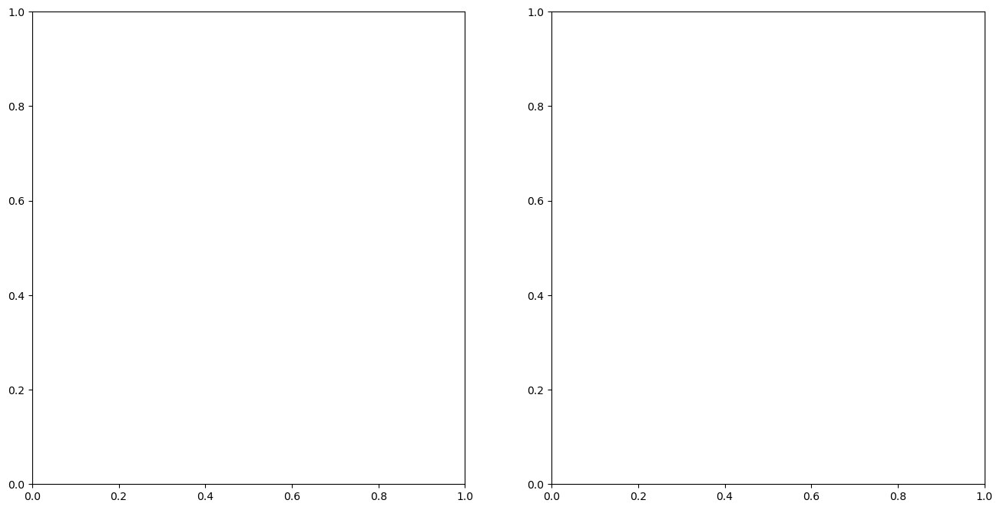

In [29]:
# Combine both histograms and heatmaps in a subplot
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', ax=axes[0])
axes[0].set_title("Correlation Heatmap")

grouped_df['ACS_TOT_POP_WT'].plot(kind='hist', bins=20, alpha=0.7, ax=axes[1])
axes[1].set_title('Histogram of ACS_TOT_POP_WT')
axes[1].set_xlabel('ACS_TOT_POP_WT')
axes[1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

# County Level Dashboard

In [30]:
#Panel HTML elements can take a 'style' parameter directly. 
#You could alternatively assign a css class as above and include the css code in raw_css
title_html_pane = pn.pane.HTML("""<h1>Social Determinants of Health Database Census Tract Data 2020</h1>""",
                              style={'color':'white','font-size':'20px','width':'145%',
                                     'background-color':'#6A5638','text-align':'center',
                                     'outline-style':'solid','outline-color':'#30231D',
                                     'outline-width':'thick','font-family':'Times New Roman'})

datalab_img = pn.pane.PNG("C:/Users/Mirna Elizondo/OneDrive - Texas State University/Desktop/Research/PAIR/data/datalabimage.png", height=171, width=280)
txst_img = pn.pane.PNG("C:/Users/Mirna Elizondo/OneDrive - Texas State University/Desktop/Research/PAIR/data/txstlog.png",height=140,width=350)


title_bar = pn.Row(pn.Spacer(width=30),datalab_img,pn.Spacer(width=55),title_html_pane,pn.Spacer(width=310),txst_img)

content_bar = pn.Row(pn.Spacer(width=225),map_component1)

#Create a new gridspec with 14 columns and 12 rows
gspec = pn.GridSpec(ncols=14,nrows=6, background='#FFFFFF',sizing_mode='stretch_both')
#Place application elements in the grid, using pn.Spacer() for improved layout spacing and control
gspec[0, 7] = title_bar
gspec[1:6, 7] = content_bar
gspec.show()

TypeError: HTML.__init__() got an unexpected keyword argument 'style'

# Heatmap & Histogram Dashboard

In [31]:
#Panel HTML elements can take a 'style' parameter directly. 
#You could alternatively assign a css class as above and include the css code in raw_css
title_html_pane = pn.pane.HTML("""<h1>Social Determinants of Health Database Census Tract Data 2020</h1>""",
                              style={'color':'white','font-size':'20px','width':'145%',
                                     'background-color':'#6A5638','text-align':'center',
                                     'outline-style':'solid','outline-color':'#30231D',
                                     'outline-width':'thick','font-family':'Times New Roman'})
datalab_img = pn.pane.PNG("datalabimage.png", height=171, width=280)
txst_img = pn.pane.PNG("txstlog.png",height=140,width=350)



title_bar = pn.Row(pn.Spacer(width=30),datalab_img,pn.Spacer(width=55),title_html_pane,pn.Spacer(width=310),txst_img)

content_bar = pn.Row(pn.Spacer(width=100),loss_component1, pn.Spacer(width=80),loss_component2)

#Create a new gridspec with 14 columns and 12 rows
gspec = pn.GridSpec(ncols=14,nrows=6, background='#FFFFFF',sizing_mode='stretch_both')
#Place application elements in the grid, using pn.Spacer() for improved layout spacing and control
gspec[0, 7] = title_bar
gspec[2:6, 7] = content_bar
gspec.show()

TypeError: HTML.__init__() got an unexpected keyword argument 'style'

# Definitions

In [32]:


#Panel HTML elements can take a 'style' parameter directly. 
#You could alternatively assign a css class as above and include the css code in raw_css
title_html_pane = pn.pane.HTML("""<h1>Social Determinants of Health Database Census Tract Data 2020</h1>""",
                              style={'color':'white','font-size':'20px','width':'145%',
                                     'background-color':'#6A5638','text-align':'center',
                                     'outline-style':'solid','outline-color':'#30231D',
                                     'outline-width':'thick','font-family':'Times New Roman'})
datalab_img = pn.pane.PNG("datalabimage.png", height=171, width=280)
txst_img = pn.pane.PNG("txstlog.png",height=140,width=350)



title_bar = pn.Row(pn.Spacer(width=30),datalab_img,pn.Spacer(width=55),title_html_pane,pn.Spacer(width=310),txst_img)
index_pane = pn.pane.HTML("""<h1>Variable Definitions</h1>""", 
                          style={'color':'white','width':'168%','font-size':'24px','text-align':'center',    
                      #    'outline-style':'solid','outline-color':'#30231D',   
                      #    'outline-width':'thick',
                                 'background-color':'#501214',
                          'font-family':'Times New Roman',
                          'border':'10px solid black'})

        descriptions = {
            'FIPS': 'Contains geographic identifiers, including census tract, county, and state FIPS codes.',
            'Population': 'Includes population-related statistics, such as total population or population by group.',
            'Demographics': 'Represents demographic percentages, such as racial or age distributions.',
            'Income': 'Includes income-related metrics like median household income or income inequality.',
            'Housing': 'Represents housing-related data, including homeownership rates, housing units, and rent statistics.',
        }
    
table = pn.pane.HTML(
"""
<table style="width:105%">
<th style = 'font-size':'8px'>
  <tr>
    <td>FIPS</td>
    <td>Contains geographic identifiers, including census tract, county, and state FIPS codes</td>
  </tr>
  <tr>
    <td>Population</td>
    <td>Includes population-related statistics, such as total population or population by group</td>
  </tr>
  <tr>
    <td>Demographics</td>
    <td>Represents demographic percentages, such as racial or age distributions.</td>
 </tr>
 <tr>
    <td>Income</td>
    <td>Includes income-related metrics like median household income or income inequality.</td>
 </tr>
 <tr>
    <td>Housing</td>
    <td>Represents housing-related data, including homeownership rates, housing units, and rent statistics.</td>
 </tr>
</table>
""", style={'width':'168%','font-size':'32px','text-align':'center',    
            #'outline-style':'solid','outline-color':'#30231D',   
           # 'outline-width':'thick',
            'font-family':'Times New Roman',
            'border':'4px solid black'})
content_bar = pn.Row(pn.Spacer(width=145),
                     pn.Column(index_pane,table))

#Create a new gridspec with 14 columns and 12 rows
gspec = pn.GridSpec(ncols=14,nrows=12, background='#FFFFFF',sizing_mode='stretch_both')
#Place application elements in the grid, using pn.Spacer() for improved layout spacing and control
gspec[0, 7] = title_bar
#gspec[1:6, 0] = pn.Spacer()
#gspec[1:6, 5] = pn.Spacer()
gspec[2:6, 7] = content_bar
gspec.show()



IndentationError: unexpected indent (2993112002.py, line 22)